# import libraries

In [1]:
import numpy as np
import sklearn.metrics as metrics
import matplotlib.pyplot as plt
import os
import cv2
from sklearn.model_selection import train_test_split
import math 
from pathlib import Path

from tensorflow.keras.callbacks import ModelCheckpoint,CSVLogger
from tensorflow.keras.models import Sequential, Model
from tensorflow.keras.layers import Input, Dense, Flatten, Reshape
from tensorflow.keras.layers import Dropout
from tensorflow.keras.layers import Conv2D, Conv2DTranspose, Concatenate
from tensorflow.keras.layers import LeakyReLU
from tensorflow.keras.layers import MaxPooling2D
from tensorflow.keras.layers import BatchNormalization
from tensorflow.keras.layers import Activation
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.callbacks import Callback
from tensorflow.keras.models import Model 

In [2]:
plt.style.use('ggplot')
plt.rcParams['ytick.right'] = True
plt.rcParams['ytick.labelright']= True
plt.rcParams['ytick.left']      = False
plt.rcParams['ytick.labelleft'] = False
plt.rcParams['font.family']     = 'Arial'

# Data preparation

In [22]:
def display2(array1, array2):
    """
    Displays ten random images from each one of the supplied arrays.
    """

    n = 10

    indices = np.random.randint(len(array1), size=n)
    images1 = array1[indices, :]
    images2 = array2[indices, :]

    plt.figure(figsize=(20, 4))
    for i, (image1, image2) in enumerate(zip(images1, images2)):
        ax = plt.subplot(2, n, i + 1)
        plt.imshow(image1)
        plt.gray()
        ax.get_xaxis().set_visible(False)
        ax.get_yaxis().set_visible(False)

        ax = plt.subplot(2, n, i + 1 + n)
        plt.imshow(image2)
        plt.gray()
        ax.get_xaxis().set_visible(False)
        ax.get_yaxis().set_visible(False)

    plt.show()
    
def display3(array1, array2, array3):
    """
    Displays ten random images from each one of the supplied arrays.
    """

    n = 10

    indices = np.random.randint(len(array1), size=n)
    images1 = array1[indices, :]
    images2 = array2[indices, :]
    images3 = array3[indices, :]

    plt.figure(figsize=(20, 6))
    for i, (image1, image2, image3) in enumerate(zip(images1, images2, images3)):
        ax = plt.subplot(3, n, i + 1)
        plt.imshow(image1)
        plt.gray()
        ax.get_xaxis().set_visible(False)
        ax.get_yaxis().set_visible(False)

        ax = plt.subplot(3, n, i + 1 + n)
        plt.imshow(image2)
        plt.gray()
        ax.get_xaxis().set_visible(False)
        ax.get_yaxis().set_visible(False)
        
        ax = plt.subplot(3, n, i + 1 + n*2)
        plt.imshow(image3)
        plt.gray()
        ax.get_xaxis().set_visible(False)
        ax.get_yaxis().set_visible(False)

    plt.show()
    
def display1(array1):
    """
    Displays ten random images from each one of the supplied arrays.
    """

    n = 10

    indices = np.random.randint(len(array1), size=n)
    images1 = array1[indices]


    plt.figure(figsize=(20, 4))
    for i, image1 in enumerate(images1):
        ax = plt.subplot(1, n, i + 1)
        plt.imshow(image1)
        ax.get_xaxis().set_visible(False)
        ax.get_yaxis().set_visible(False)


    plt.show()

In [4]:
# params
IMAGE_SIZE = (128, 128)
# ENCODER_DIM = 1024

def getImageData(fn_list, file_path):
    all_imgs = []
    for fn in fn_list:
        img = cv2.imread(file_path + fn)
        img_flip_along_y = cv2.flip(img, 1)
        
        img = cv2.resize(img, IMAGE_SIZE).astype('float32') / 255.0
        img_flip_along_y = cv2.resize(img_flip_along_y, IMAGE_SIZE).astype('float32') / 255.0
        
        all_imgs += [np.expand_dims(img, 0)]
        all_imgs += [np.expand_dims(img_flip_along_y, 0)]
    return np.vstack(all_imgs)

def getFnList(path):
    files = os.listdir(path)
    return files

(1077, 128, 128, 3)


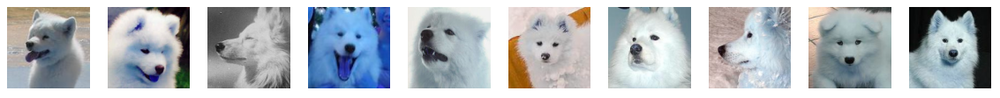

(935, 128, 128, 3)


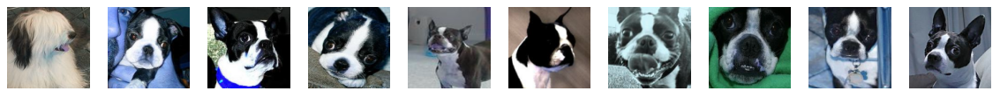

In [34]:
# tiger
# file_path_A = '../input/subanimalfaces/n02129604/n02129604/'
# fox dog
# file_path_A = '../input/subanimalfaces/n02111889/n02111889/'
# file_path_A = '../input/subanimalfaces/n02111889/n02111889/'
file_path_A = '../input/myanimalfaces/n02111889/n02111889/'
# file_path_A = '../input/animal-faces/afhq/val/cat/'
# er ha
# file_path_B = '../input/subanimalfaces/n02110063/n02110063/'
# fa dou
# file_path_B = '../input/fadoudog/n02096585/'
file_path_B = '../input/myanimalfaces/n02096585/n02096585/'
# file_path_B = '../input/animal-faces/afhq/val/dog/'

data_A = getImageData(getFnList(file_path_A), file_path_A)
train_data_A, test_data_A = train_test_split(data_A, test_size=0.33)
print(train_data_A.shape)
display1(train_data_A)

data_B = getImageData(getFnList(file_path_B), file_path_B)
train_data_B, test_data_B = train_test_split(data_B, test_size=0.33)
print(train_data_B.shape)
display1(train_data_B)

# build model

In [26]:
!pip install git+https://www.github.com/keras-team/keras-contrib.git

  Cloning https://www.github.com/keras-team/keras-contrib.git to /tmp/pip-req-build-q57sx02y
  Running command git clone -q https://www.github.com/keras-team/keras-contrib.git /tmp/pip-req-build-q57sx02y
  Resolved https://www.github.com/keras-team/keras-contrib.git to commit 3fc5ef709e061416f4bc8a92ca3750c824b5d2b0


In [51]:
# example of defining a 70x70 patchgan discriminator model
from tensorflow.keras.initializers import RandomNormal
from keras_contrib.layers.normalization.instancenormalization import InstanceNormalization

# define the discriminator model
def define_discriminator(image_shape):
	# weight initialization
	init = RandomNormal(stddev=0.02)
	# source image input
	in_image = Input(shape=image_shape)
	# C64
	d = Conv2D(64, (4,4), strides=(2,2), padding='same', kernel_initializer=init)(in_image)
	d = LeakyReLU(alpha=0.2)(d)
	# C128
	d = Conv2D(128, (4,4), strides=(2,2), padding='same', kernel_initializer=init)(d)
	d = InstanceNormalization(axis=-1)(d)
	d = LeakyReLU(alpha=0.2)(d)
	# C256
	d = Conv2D(256, (4,4), strides=(2,2), padding='same', kernel_initializer=init)(d)
	d = InstanceNormalization(axis=-1)(d)
	d = LeakyReLU(alpha=0.2)(d)
	# C512
	d = Conv2D(512, (4,4), strides=(2,2), padding='same', kernel_initializer=init)(d)
	d = InstanceNormalization(axis=-1)(d)
	d = LeakyReLU(alpha=0.2)(d)
	# second last output layer
	d = Conv2D(512, (4,4), padding='same', kernel_initializer=init)(d)
	d = InstanceNormalization(axis=-1)(d)
	d = LeakyReLU(alpha=0.2)(d)
	# patch output
	patch_out = Conv2D(1, (4,4), padding='same', kernel_initializer=init)(d)
	# define model
	model = Model(in_image, patch_out)
	# compile model
	model.compile(loss='mse', optimizer=Adam(lr=0.0002, beta_1=0.5), loss_weights=[0.5])
	return model

In [36]:
# generator a resnet block
def resnet_block(n_filters, input_layer):
	# weight initialization
	init = RandomNormal(stddev=0.02)
	# first layer convolutional layer
	g = Conv2D(n_filters, (3,3), padding='same', kernel_initializer=init)(input_layer)
	g = InstanceNormalization(axis=-1)(g)
	g = Activation('relu')(g)
	# second convolutional layer
	g = Conv2D(n_filters, (3,3), padding='same', kernel_initializer=init)(g)
	g = InstanceNormalization(axis=-1)(g)
	# concatenate merge channel-wise with input layer
	g = Concatenate()([g, input_layer])
	return g

In [52]:
class MyModel():
    def __init__(self):
        self.g_A2B = self.define_generator()
        self.g_B2A = self.define_generator()
        
    def define_generator(self, image_shape=(128,128,3), n_resnet=2):
        # weight initialization
        init = RandomNormal(stddev=0.02)
        # image input
        in_image = Input(shape=image_shape)
        # c7s1-64
        g = Conv2D(64, (7,7), padding='same', kernel_initializer=init)(in_image)
        g = InstanceNormalization(axis=-1)(g)
        g = Activation('relu')(g)
        # d128
        g = Conv2D(128, (3,3), strides=(2,2), padding='same', kernel_initializer=init)(g)
        g = InstanceNormalization(axis=-1)(g)
        g = Activation('relu')(g)
        # d256
        g = Conv2D(256, (3,3), strides=(2,2), padding='same', kernel_initializer=init)(g)
        g = InstanceNormalization(axis=-1)(g)
        g = Activation('relu')(g)
        # R256
        for _ in range(n_resnet):
            g = resnet_block(256, g)
        # u128
        g = Conv2DTranspose(128, (3,3), strides=(2,2), padding='same', kernel_initializer=init)(g)
        g = InstanceNormalization(axis=-1)(g)
        g = Activation('relu')(g)
        # u64
        g = Conv2DTranspose(64, (3,3), strides=(2,2), padding='same', kernel_initializer=init)(g)
        g = InstanceNormalization(axis=-1)(g)
        g = Activation('relu')(g)
        # c7s1-3
        g = Conv2D(3, (7,7), padding='same', kernel_initializer=init)(g)
        g = InstanceNormalization(axis=-1)(g)
        out_image = Activation('tanh')(g)
        # define model
        model = Model(in_image, out_image)
        return model
        
        
    def load_weights(self):
        try:
            self.g_A2B.load_weights(model_dir + g_A2BH5)
            self.g_B2A.load_weights(model_dir + g_B2AH5)
            d_A.load_weights(model_dir + d_AH5)
            d_B.load_weights(model_dir + d_BH5)
            print('loaded model weights')
            return True
        except Exception as e:
            print('Failed loading existing training data.')
            print(e)
            return False

    def save_weights(self):
        self.g_A2B.save_weights(model_dir + g_A2BH5)
        self.g_B2A.save_weights(model_dir + g_B2AH5)
        print('saved generator weights')
        d_A.save_weights(model_dir + d_AH5)
        d_B.save_weights(model_dir + d_BH5)
        print('saved discriminator weights')

In [53]:
my_model = MyModel()
my_model.g_A2B.summary()

Model: "model_32"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_41 (InputLayer)           [(None, 128, 128, 3) 0                                            
__________________________________________________________________________________________________
conv2d_176 (Conv2D)             (None, 128, 128, 64) 9472        input_41[0][0]                   
__________________________________________________________________________________________________
instance_normalization_192 (Ins (None, 128, 128, 64) 128         conv2d_176[0][0]                 
__________________________________________________________________________________________________
activation_128 (Activation)     (None, 128, 128, 64) 0           instance_normalization_192[0][0] 
___________________________________________________________________________________________

In [54]:
my_model = MyModel()
g_A2B = my_model.g_A2B
g_B2A = my_model.g_B2A
# input shape
image_shape = (128,128,3)
# discriminator: A -> [real/fake]
d_A = define_discriminator(image_shape)
# discriminator: B -> [real/fake]
d_B = define_discriminator(image_shape)

In [55]:
# define a composite model for updating generators by adversarial and cycle loss
def define_composite_model(g_model_1, d_model, g_model_2, image_shape):
	# ensure the model we're updating is trainable
	g_model_1.trainable = True
	# mark discriminator as not trainable
	d_model.trainable = False
	# mark other generator model as not trainable
	g_model_2.trainable = False
	# discriminator element
	input_gen = Input(shape=image_shape)
	gen1_out = g_model_1(input_gen)
	output_d = d_model(gen1_out)
	# identity element
	input_id = Input(shape=image_shape)
	output_id = g_model_1(input_id)
	# forward cycle
	output_f = g_model_2(gen1_out)
	# backward cycle
	gen2_out = g_model_2(input_id)
	output_b = g_model_1(gen2_out)
	# define model graph
	model = Model([input_gen, input_id], [output_d, output_id, output_f, output_b])
	# define optimization algorithm configuration
	opt = Adam(lr=0.0002, beta_1=0.5)
	# compile model with weighting of least squares loss and L1 loss
    # adversial loss, identity loss, forward loss, backward loss
	model.compile(loss=['mse', 'mae', 'mae', 'mae'], loss_weights=[1, 1, 10, 10], optimizer=opt)
	return model

In [56]:
# composite: A -> B -> [real/fake, A]
c_model_AtoB = define_composite_model(g_A2B, d_B, g_B2A, image_shape)
# composite: B -> A -> [real/fake, B]
c_model_BtoA = define_composite_model(g_B2A, d_A, g_A2B, image_shape)

# train model

In [57]:
g_A2BH5 = 'g_A2B.h5'
g_B2AH5 = 'g_B2A.h5'
d_AH5 = 'd_A.h5'
d_BH5 = 'd_B.h5'
model_dir = './my_model_fadou_foxDog/'

In [58]:
# !rm -rf ./my_model_fadou_foxDog

In [16]:
# !zip -r ddd7.zip ./my_model_fadou_foxDog

In [59]:
from random import sample
# select a batch of random samples, returns images and target
def generate_real_samples(dataset, n_samples, patch_shape):
    # choose random instances
#     ix = sample(range(0, dataset.shape[0]-1), n_samples)
    # retrieve selected images
#     X = dataset[ix]
    X = dataset
    n = len(X)
    # generate 'real' class labels (1)
    y = np.ones((n, patch_shape, patch_shape, 1))
    return X, y

In [18]:
# generate a batch of images, returns images and targets
def generate_fake_samples(g_model, dataset, patch_shape):
	# generate fake instance
	X = g_model.predict(dataset)
	# create 'fake' class labels (0)
	y = np.zeros((len(X), patch_shape, patch_shape, 1))
	return X, y

In [19]:
from random import randint
from random import random
# update image pool for fake images
def update_image_pool(pool, images, max_size=50):
	selected = list()
	for image in images:
		if len(pool) < max_size:
			# stock the pool
			pool.append(image)
			selected.append(image)
		elif random() < 0.5:
			# use image, but don't add it to the pool
			selected.append(image)
		else:
			# replace an existing image and use replaced image
			ix = randint(0, len(pool)-1)
			selected.append(pool[ix])
			pool[ix] = image
	return np.asarray(selected)

Failed loading existing training data.
Unable to open file (unable to open file: name = './my_model_fadou_foxDog/g_A2B.h5', errno = 2, error message = 'No such file or directory', flags = 0, o_flags = 0)
==== epoch 0
discriminator loss: B_on_real: 0.1204, B_on_fake: 0.1594, A_on_real: 0.0778, A_on_fake: 0.0906
generator A2B loss: total: 8.5693, adversarial: 0.7736, identity: 0.3619, forward: 0.4249, backward: 0.3185
generator B2A loss: total: 8.7619, adversarial: 0.7802, identity: 0.5531, forward: 0.3179, backward: 0.4249
============= train set ================
====== A as input


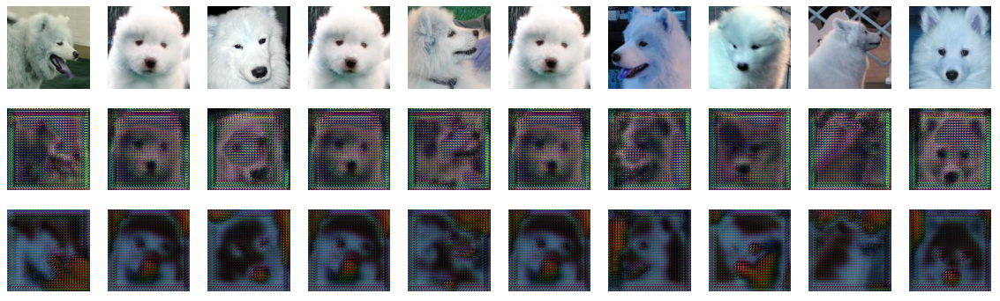

====== B as input


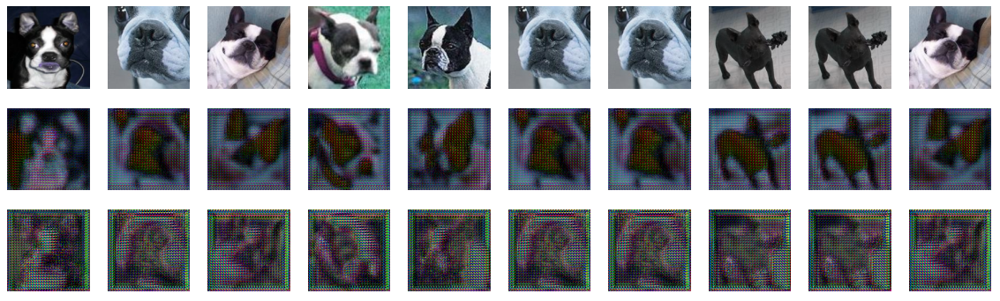

============= test set ================
====== A as input


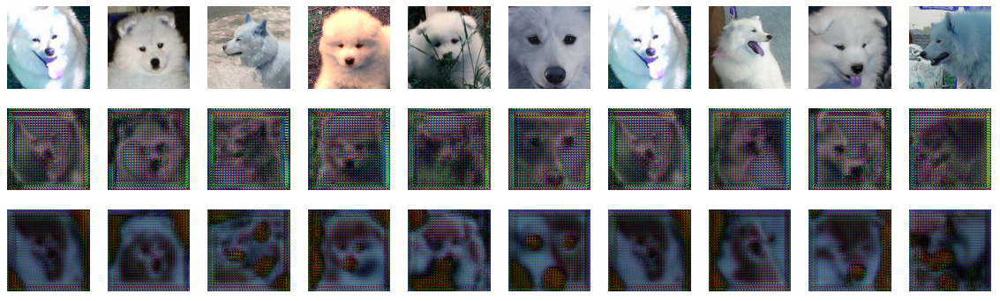

====== B as input


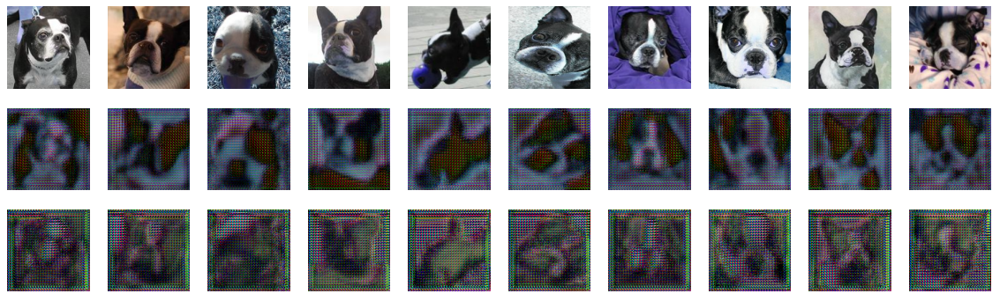

saved generator weights
saved discriminator weights
==== epoch 1
discriminator loss: B_on_real: 0.1483, B_on_fake: 0.1125, A_on_real: 0.0444, A_on_fake: 0.0928
generator A2B loss: total: 8.4328, adversarial: 0.9467, identity: 0.4473, forward: 0.4098, backward: 0.2941
generator B2A loss: total: 8.4329, adversarial: 0.8170, identity: 0.5593, forward: 0.2938, backward: 0.4118
==== epoch 2
discriminator loss: B_on_real: 0.0489, B_on_fake: 0.0732, A_on_real: 0.1997, A_on_fake: 0.0750
generator A2B loss: total: 8.0214, adversarial: 0.8788, identity: 0.4013, forward: 0.3951, backward: 0.2790
generator B2A loss: total: 8.5700, adversarial: 1.3156, identity: 0.5153, forward: 0.2787, backward: 0.3952
==== epoch 3
discriminator loss: B_on_real: 0.0264, B_on_fake: 0.0464, A_on_real: 0.0240, A_on_fake: 0.0344
generator A2B loss: total: 7.8099, adversarial: 0.9275, identity: 0.3805, forward: 0.3821, backward: 0.2681
generator B2A loss: total: 8.0357, adversarial: 1.0379, identity: 0.4838, forward: 0

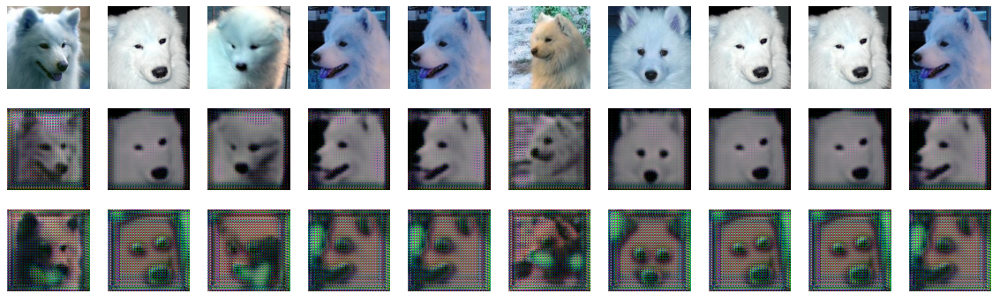

====== B as input


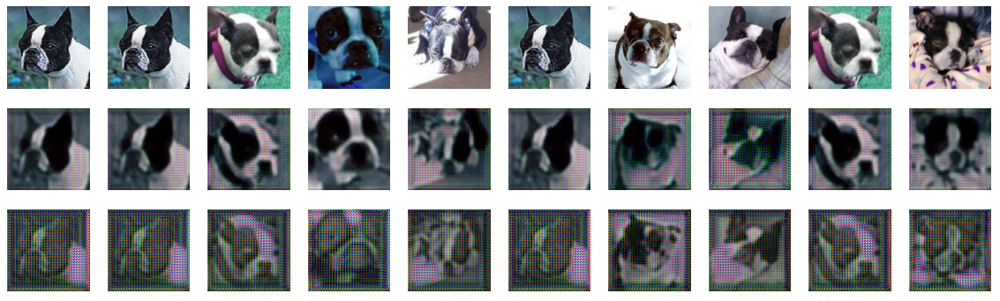

============= test set ================
====== A as input


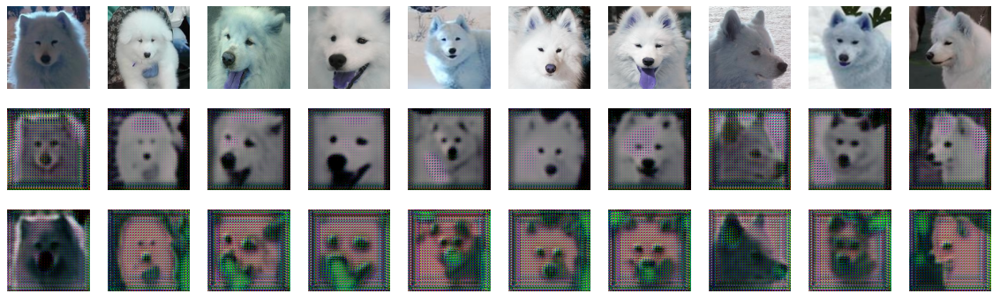

====== B as input


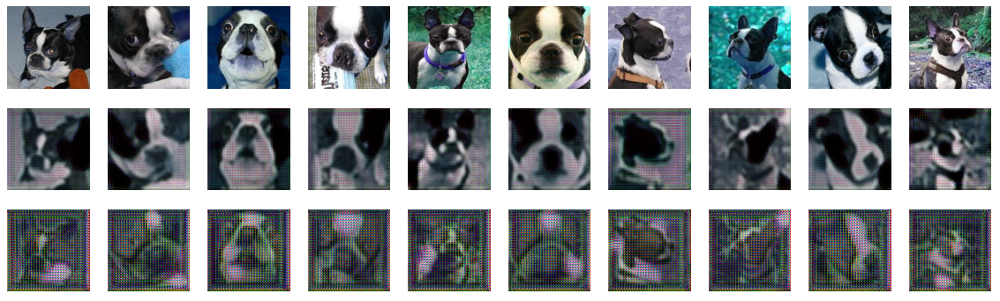

saved generator weights
saved discriminator weights
==== epoch 11
discriminator loss: B_on_real: 0.0081, B_on_fake: 0.0140, A_on_real: 0.0135, A_on_fake: 0.0999
generator A2B loss: total: 6.3873, adversarial: 0.9401, identity: 0.2394, forward: 0.3045, backward: 0.2163
generator B2A loss: total: 6.3017, adversarial: 0.7275, identity: 0.4006, forward: 0.2145, backward: 0.3029
==== epoch 12
discriminator loss: B_on_real: 0.0049, B_on_fake: 0.0101, A_on_real: 0.0141, A_on_fake: 0.0208
generator A2B loss: total: 6.0365, adversarial: 0.9121, identity: 0.2185, forward: 0.2885, backward: 0.2021
generator B2A loss: total: 6.2539, adversarial: 1.0119, identity: 0.3614, forward: 0.2001, backward: 0.2880
==== epoch 13
discriminator loss: B_on_real: 0.0098, B_on_fake: 0.0126, A_on_real: 0.0050, A_on_fake: 0.0056
generator A2B loss: total: 5.9672, adversarial: 0.8242, identity: 0.3455, forward: 0.2837, backward: 0.1961
generator B2A loss: total: 6.1805, adversarial: 1.0831, identity: 0.3170, forward

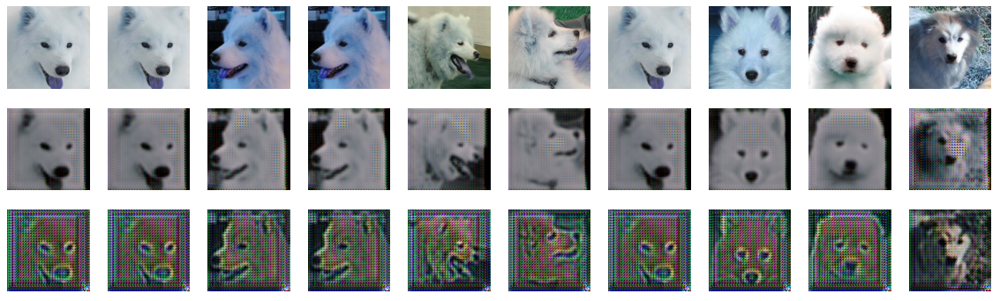

====== B as input


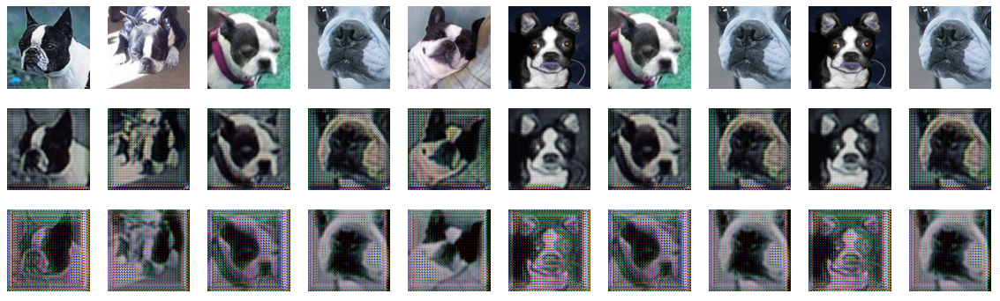

============= test set ================
====== A as input


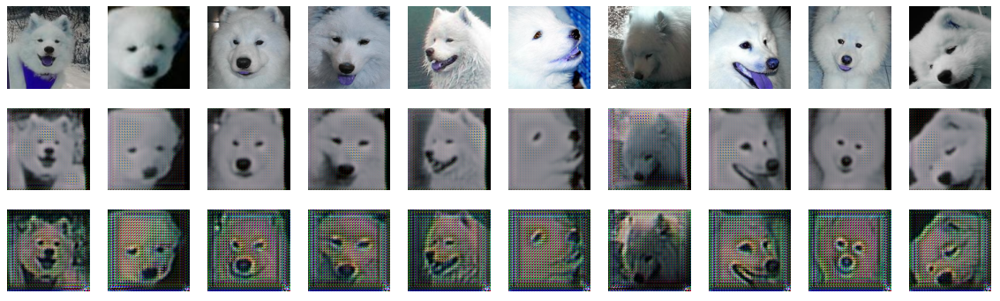

====== B as input


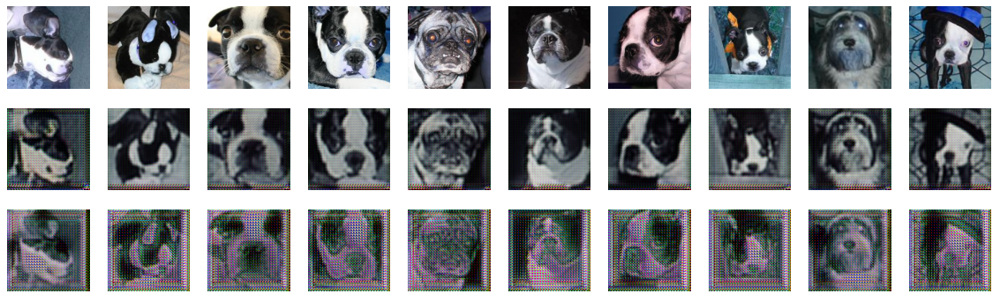

saved generator weights
saved discriminator weights
==== epoch 21
discriminator loss: B_on_real: 0.0082, B_on_fake: 0.0097, A_on_real: 0.0141, A_on_fake: 0.0367
generator A2B loss: total: 4.9410, adversarial: 0.7990, identity: 0.2316, forward: 0.2342, backward: 0.1569
generator B2A loss: total: 5.3415, adversarial: 1.0691, identity: 0.2670, forward: 0.1556, backward: 0.2450
==== epoch 22
discriminator loss: B_on_real: 0.0020, B_on_fake: 0.0032, A_on_real: 0.0034, A_on_fake: 0.0052
generator A2B loss: total: 4.8681, adversarial: 0.9497, identity: 0.2109, forward: 0.2266, backward: 0.1441
generator B2A loss: total: 4.8987, adversarial: 0.9724, identity: 0.2403, forward: 0.1437, backward: 0.2249
==== epoch 23
discriminator loss: B_on_real: 0.0031, B_on_fake: 0.0042, A_on_real: 0.0220, A_on_fake: 0.0074
generator A2B loss: total: 4.9537, adversarial: 0.9709, identity: 0.2059, forward: 0.2319, backward: 0.1458
generator B2A loss: total: 4.9329, adversarial: 0.8058, identity: 0.2976, forward

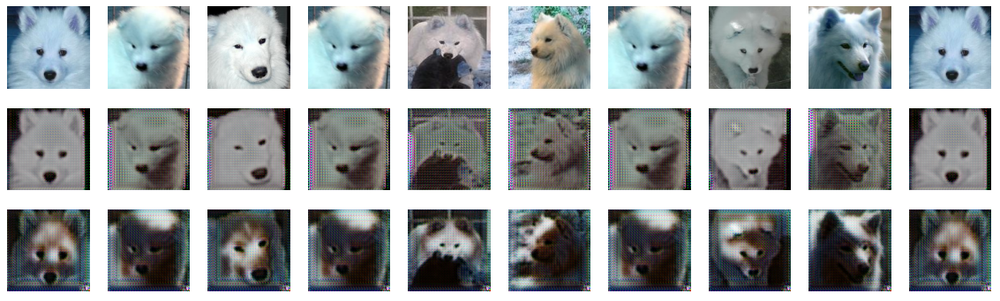

====== B as input


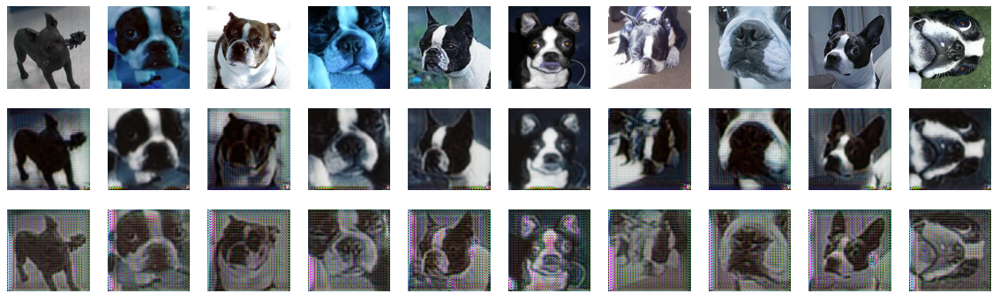

============= test set ================
====== A as input


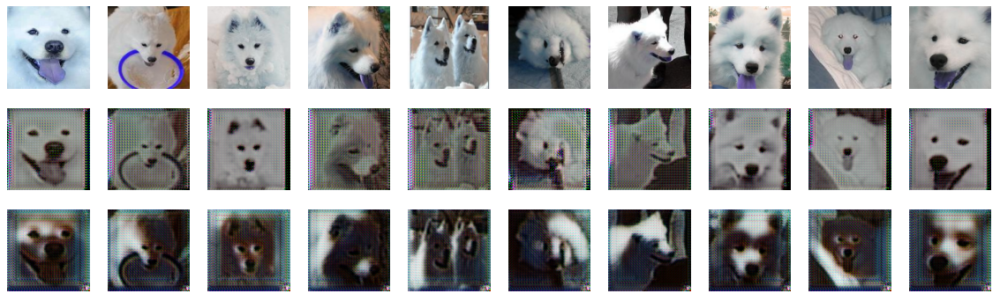

====== B as input


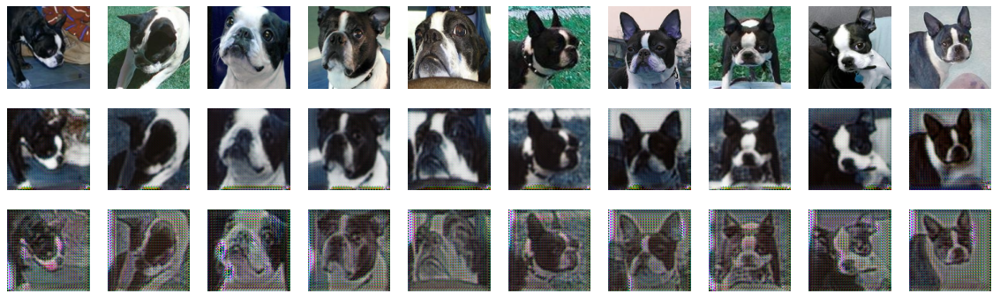

saved generator weights
saved discriminator weights
==== epoch 31
discriminator loss: B_on_real: 0.0248, B_on_fake: 0.0088, A_on_real: 0.0025, A_on_fake: 0.0079
generator A2B loss: total: 4.0094, adversarial: 0.7135, identity: 0.1845, forward: 0.1873, backward: 0.1239
generator B2A loss: total: 4.2556, adversarial: 0.9116, identity: 0.2217, forward: 0.1229, backward: 0.1894
==== epoch 32
discriminator loss: B_on_real: 0.0010, B_on_fake: 0.0027, A_on_real: 0.0073, A_on_fake: 0.0055
generator A2B loss: total: 4.1411, adversarial: 0.9662, identity: 0.1652, forward: 0.1772, backward: 0.1237
generator B2A loss: total: 4.2779, adversarial: 1.0947, identity: 0.2136, forward: 0.1198, backward: 0.1771
==== epoch 33
discriminator loss: B_on_real: 0.0280, B_on_fake: 0.0029, A_on_real: 0.0041, A_on_fake: 0.0119
generator A2B loss: total: 4.0048, adversarial: 0.9483, identity: 0.1431, forward: 0.1717, backward: 0.1197
generator B2A loss: total: 3.8744, adversarial: 0.7608, identity: 0.2172, forward

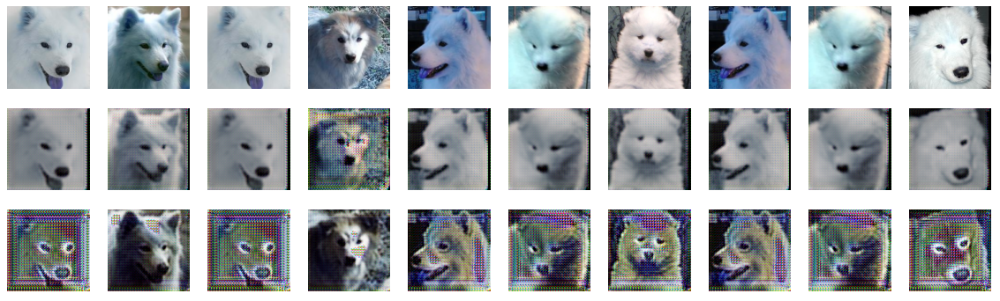

====== B as input


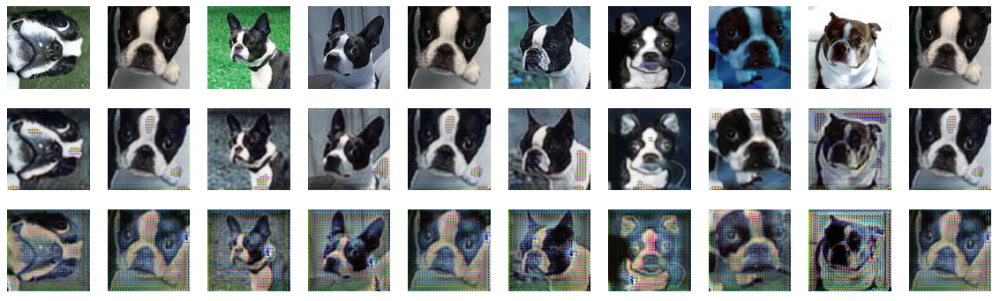

============= test set ================
====== A as input


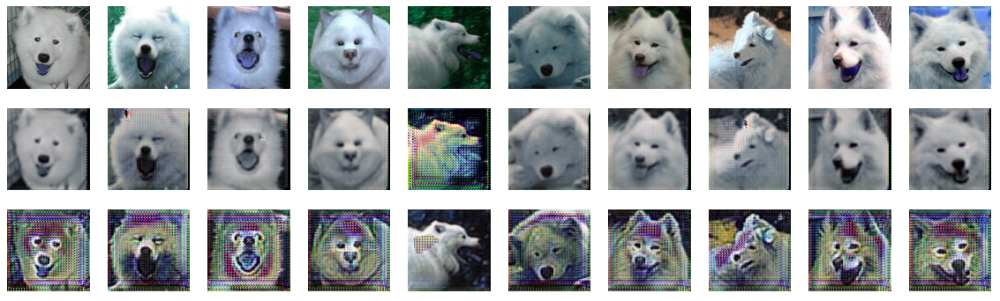

====== B as input


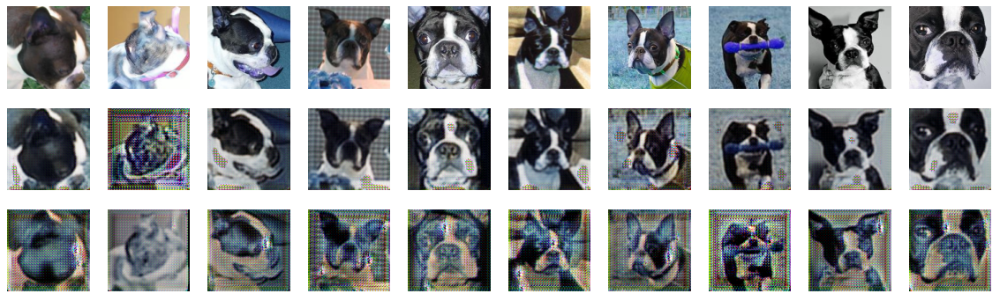

saved generator weights
saved discriminator weights
==== epoch 41
discriminator loss: B_on_real: 0.0157, B_on_fake: 0.0079, A_on_real: 0.0091, A_on_fake: 0.0095
generator A2B loss: total: 3.7260, adversarial: 1.0218, identity: 0.1589, forward: 0.1436, backward: 0.1109
generator B2A loss: total: 3.5632, adversarial: 0.8671, identity: 0.1745, forward: 0.1094, backward: 0.1428
==== epoch 42
discriminator loss: B_on_real: 0.0007, B_on_fake: 0.0013, A_on_real: 0.0029, A_on_fake: 0.0043
generator A2B loss: total: 3.5734, adversarial: 0.9958, identity: 0.1411, forward: 0.1394, backward: 0.1043
generator B2A loss: total: 3.5553, adversarial: 0.9694, identity: 0.1700, forward: 0.1024, backward: 0.1391
==== epoch 43
discriminator loss: B_on_real: 0.0672, B_on_fake: 0.2746, A_on_real: 0.0018, A_on_fake: 0.0015
generator A2B loss: total: 3.4699, adversarial: 0.9184, identity: 0.1343, forward: 0.1382, backward: 0.1035
generator B2A loss: total: 3.5376, adversarial: 0.9801, identity: 0.1594, forward

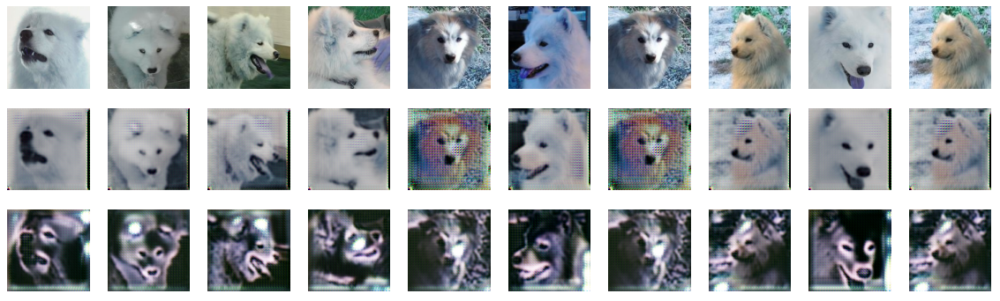

====== B as input


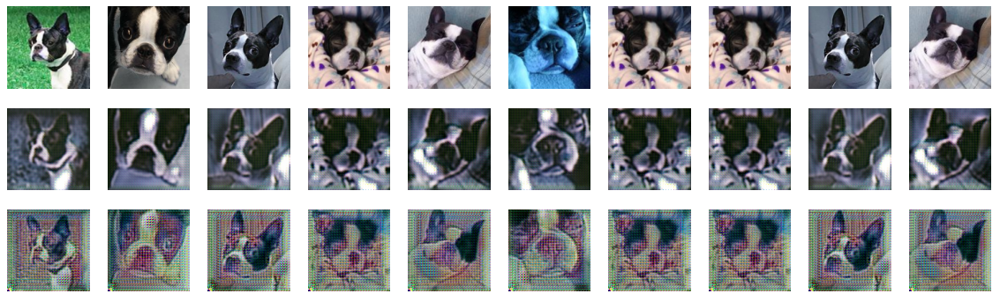

============= test set ================
====== A as input


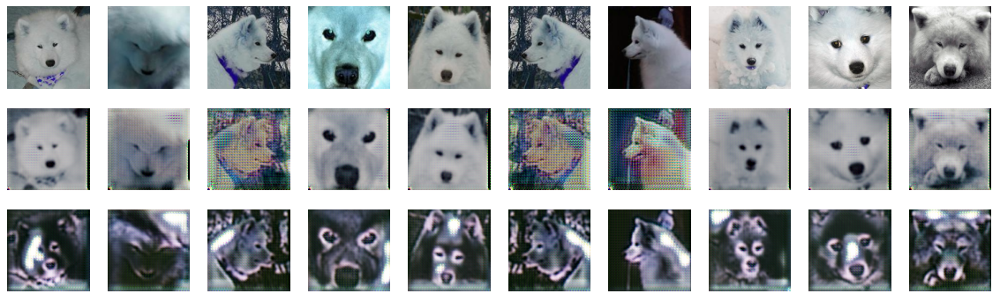

====== B as input


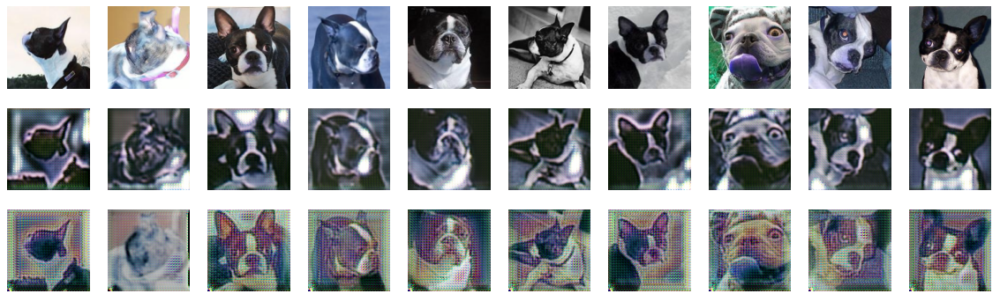

saved generator weights
saved discriminator weights
==== epoch 51
discriminator loss: B_on_real: 0.0304, B_on_fake: 0.0202, A_on_real: 0.0029, A_on_fake: 0.0024
generator A2B loss: total: 3.0846, adversarial: 0.7083, identity: 0.1483, forward: 0.1296, backward: 0.0932
generator B2A loss: total: 3.2616, adversarial: 0.9349, identity: 0.1415, forward: 0.0924, backward: 0.1261
==== epoch 52
discriminator loss: B_on_real: 0.0295, B_on_fake: 0.0574, A_on_real: 0.0066, A_on_fake: 0.0028
generator A2B loss: total: 2.7575, adversarial: 0.4050, identity: 0.1410, forward: 0.1269, backward: 0.0942
generator B2A loss: total: 3.1638, adversarial: 0.8486, identity: 0.1437, forward: 0.0932, backward: 0.1239
==== epoch 53
discriminator loss: B_on_real: 0.0645, B_on_fake: 0.0448, A_on_real: 0.0025, A_on_fake: 0.0026
generator A2B loss: total: 3.1329, adversarial: 0.7988, identity: 0.1419, forward: 0.1282, backward: 0.0911
generator B2A loss: total: 3.1909, adversarial: 0.9167, identity: 0.1455, forward

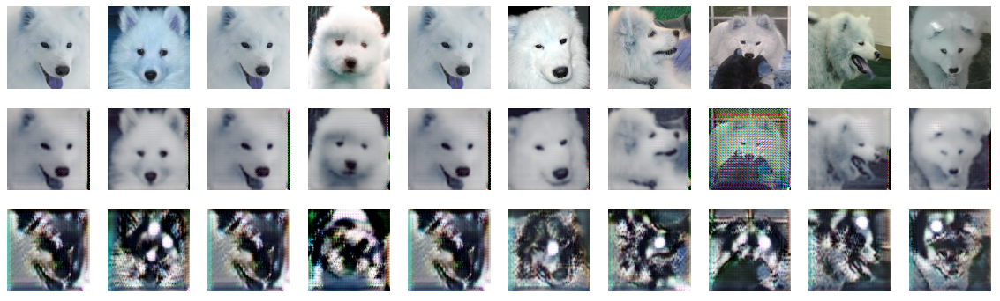

====== B as input


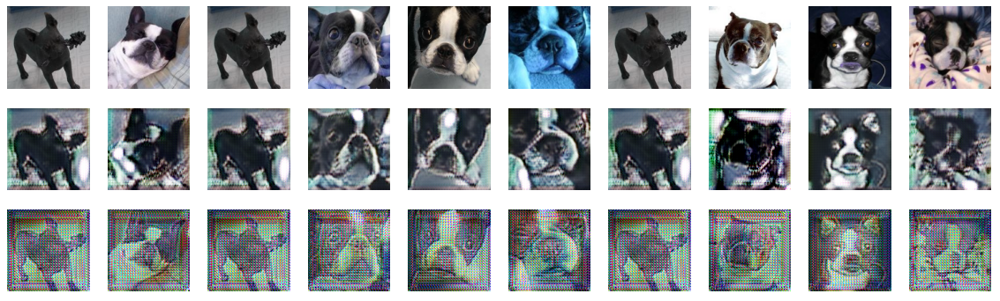

============= test set ================
====== A as input


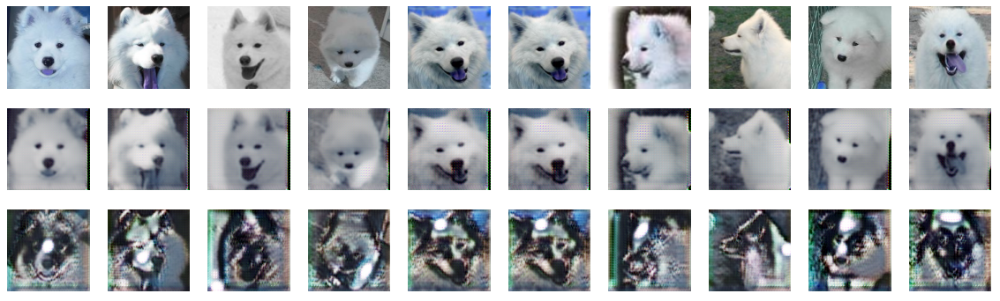

====== B as input


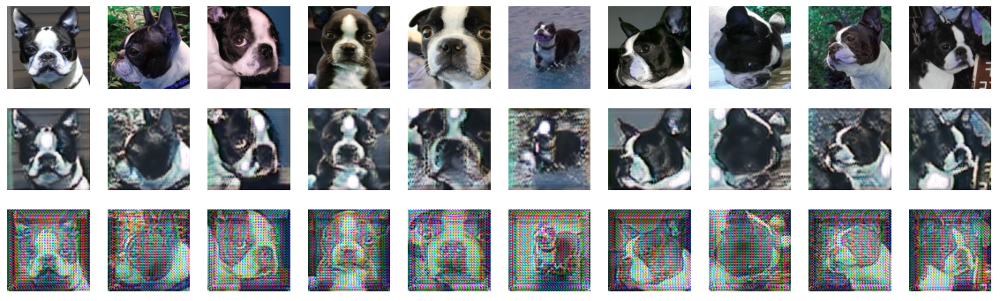

saved generator weights
saved discriminator weights
==== epoch 61
discriminator loss: B_on_real: 0.0250, B_on_fake: 0.0195, A_on_real: 0.0062, A_on_fake: 0.0027
generator A2B loss: total: 3.2011, adversarial: 0.9624, identity: 0.1357, forward: 0.1177, backward: 0.0926
generator B2A loss: total: 3.1330, adversarial: 0.9279, identity: 0.1435, forward: 0.0911, backward: 0.1151
==== epoch 62
discriminator loss: B_on_real: 0.0447, B_on_fake: 0.0125, A_on_real: 0.0049, A_on_fake: 0.0090
generator A2B loss: total: 3.3072, adversarial: 1.1167, identity: 0.1241, forward: 0.1137, backward: 0.0929
generator B2A loss: total: 3.0754, adversarial: 0.8913, identity: 0.1244, forward: 0.0913, backward: 0.1147
==== epoch 63
discriminator loss: B_on_real: 0.0267, B_on_fake: 0.0343, A_on_real: 0.0282, A_on_fake: 0.0281
generator A2B loss: total: 3.6142, adversarial: 0.8487, identity: 0.3185, forward: 0.1416, backward: 0.1031
generator B2A loss: total: 3.2828, adversarial: 0.8948, identity: 0.1576, forward

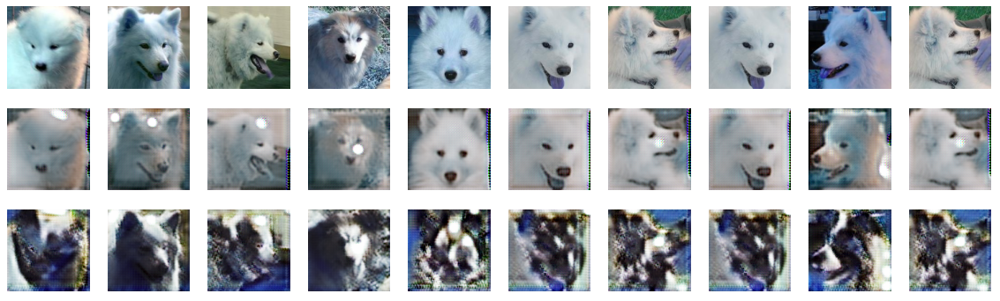

====== B as input


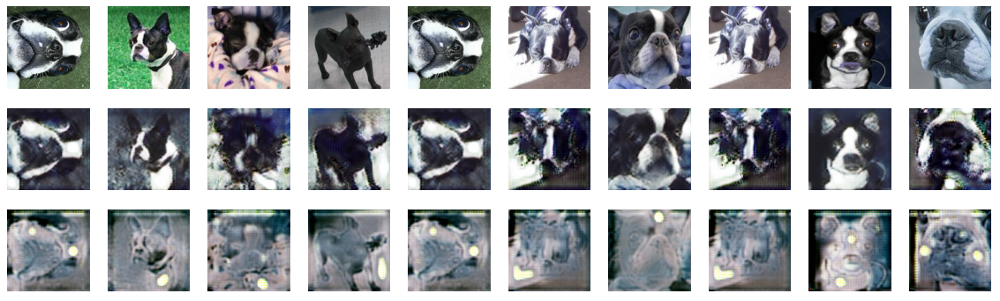

============= test set ================
====== A as input


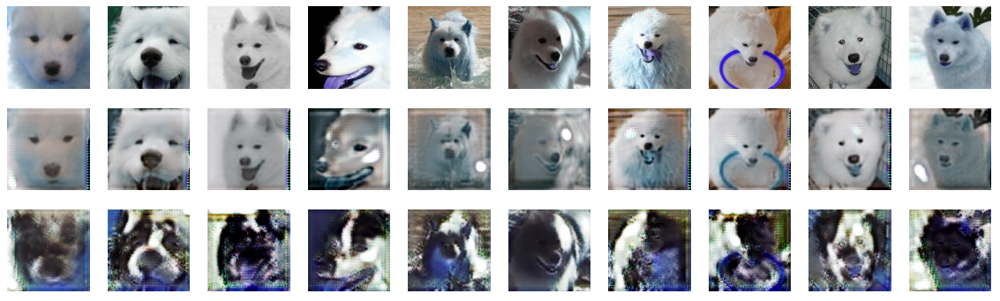

====== B as input


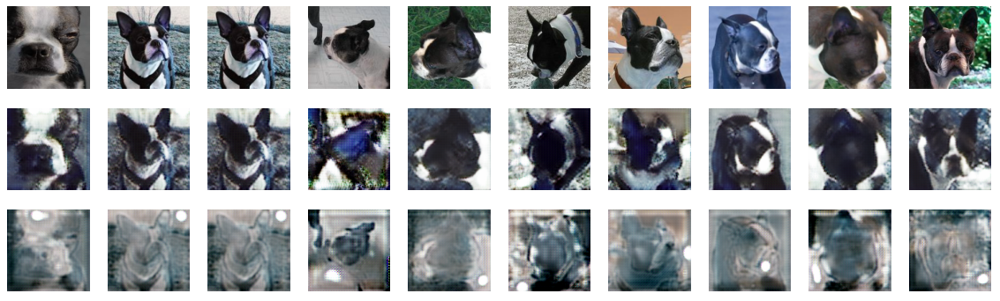

saved generator weights
saved discriminator weights
==== epoch 71
discriminator loss: B_on_real: 0.0156, B_on_fake: 0.0165, A_on_real: 0.0601, A_on_fake: 0.0482
generator A2B loss: total: 3.1990, adversarial: 0.9287, identity: 0.1329, forward: 0.1176, backward: 0.0961
generator B2A loss: total: 2.8851, adversarial: 0.6935, identity: 0.1311, forward: 0.0966, backward: 0.1094
==== epoch 72
discriminator loss: B_on_real: 0.0211, B_on_fake: 0.0288, A_on_real: 0.1209, A_on_fake: 0.0991
generator A2B loss: total: 2.8670, adversarial: 0.7328, identity: 0.1407, forward: 0.1039, backward: 0.0955
generator B2A loss: total: 3.1514, adversarial: 1.0773, identity: 0.1392, forward: 0.0935, backward: 0.1000
==== epoch 73
discriminator loss: B_on_real: 0.0415, B_on_fake: 0.0223, A_on_real: 0.1469, A_on_fake: 0.0250
generator A2B loss: total: 3.0864, adversarial: 1.0141, identity: 0.1306, forward: 0.0995, backward: 0.0947
generator B2A loss: total: 3.2063, adversarial: 1.1596, identity: 0.1249, forward

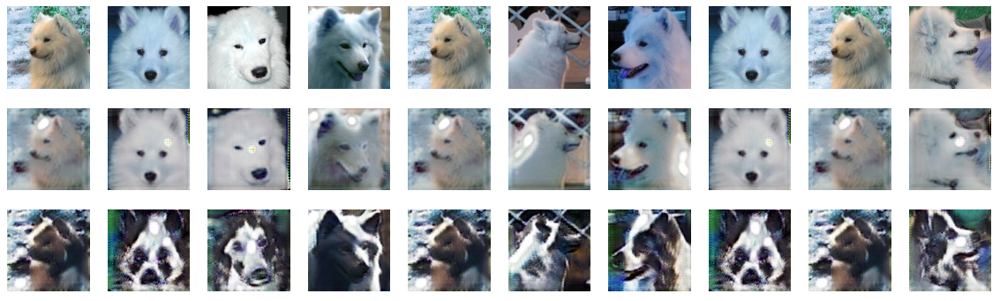

====== B as input


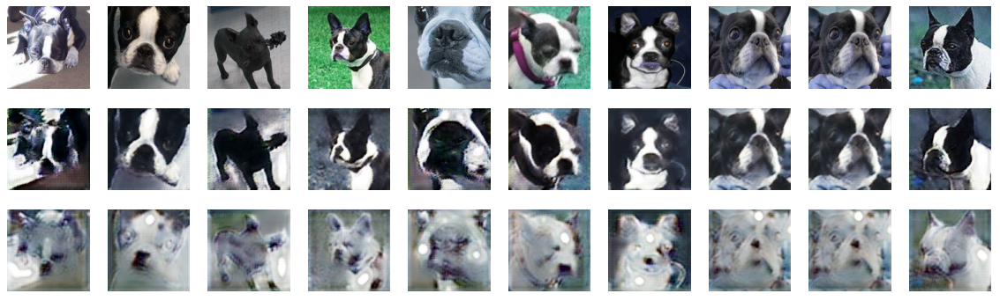

============= test set ================
====== A as input


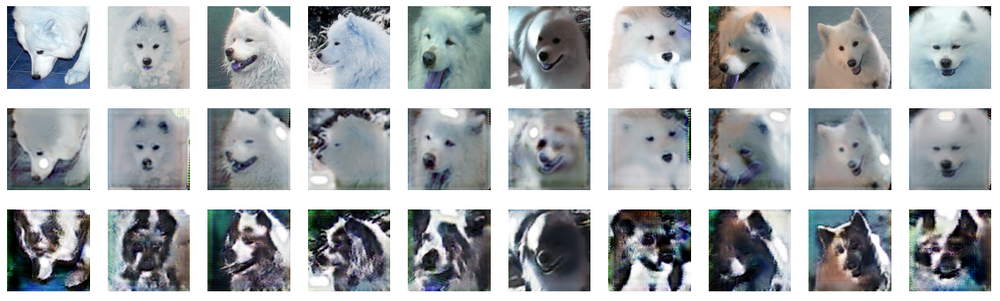

====== B as input


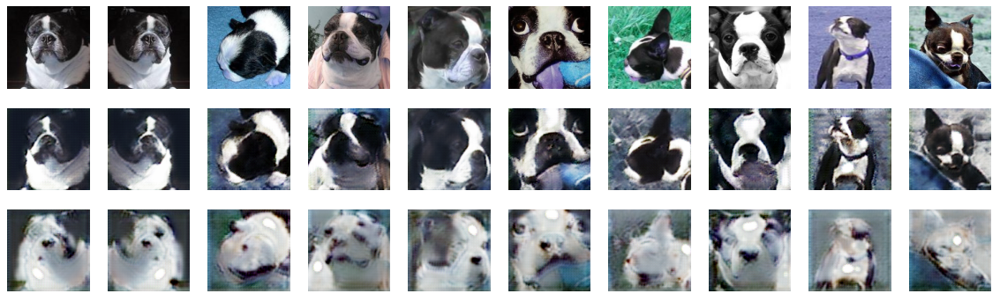

saved generator weights
saved discriminator weights
==== epoch 81
discriminator loss: B_on_real: 0.0274, B_on_fake: 0.0237, A_on_real: 0.0733, A_on_fake: 0.0558
generator A2B loss: total: 2.9198, adversarial: 0.8471, identity: 0.1335, forward: 0.1042, backward: 0.0897
generator B2A loss: total: 2.8006, adversarial: 0.9234, identity: 0.1166, forward: 0.0891, backward: 0.0870
==== epoch 82
discriminator loss: B_on_real: 0.1177, B_on_fake: 0.0531, A_on_real: 0.0292, A_on_fake: 0.0277
generator A2B loss: total: 3.0846, adversarial: 1.1311, identity: 0.1421, forward: 0.0882, backward: 0.0929
generator B2A loss: total: 2.6808, adversarial: 0.8113, identity: 0.1080, forward: 0.0914, backward: 0.0847
==== epoch 83
discriminator loss: B_on_real: 0.0115, B_on_fake: 0.0203, A_on_real: 0.0726, A_on_fake: 0.0447
generator A2B loss: total: 2.8952, adversarial: 0.9081, identity: 0.1287, forward: 0.0894, backward: 0.0964
generator B2A loss: total: 2.7944, adversarial: 0.8995, identity: 0.1081, forward

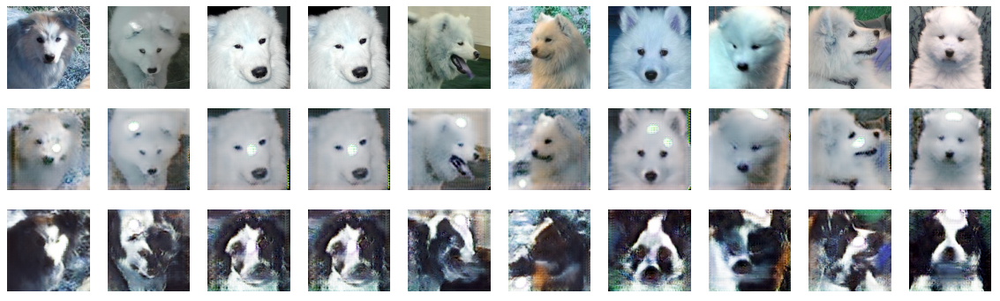

====== B as input


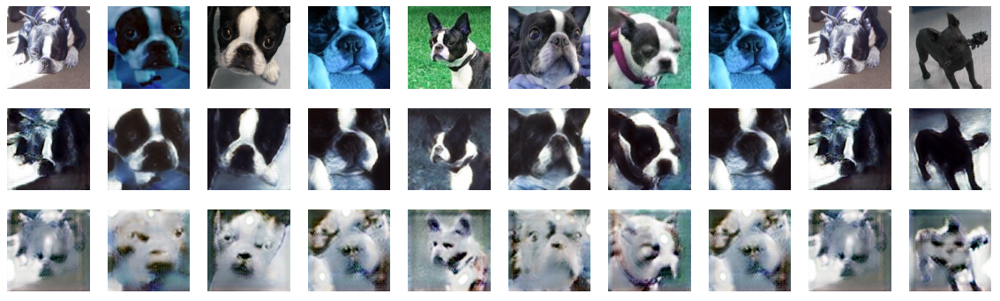

============= test set ================
====== A as input


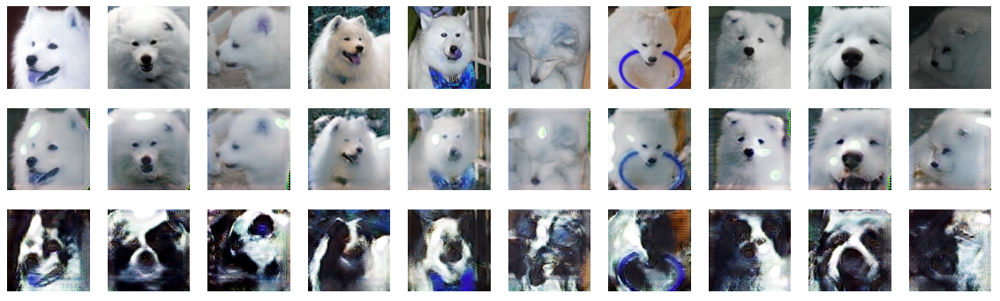

====== B as input


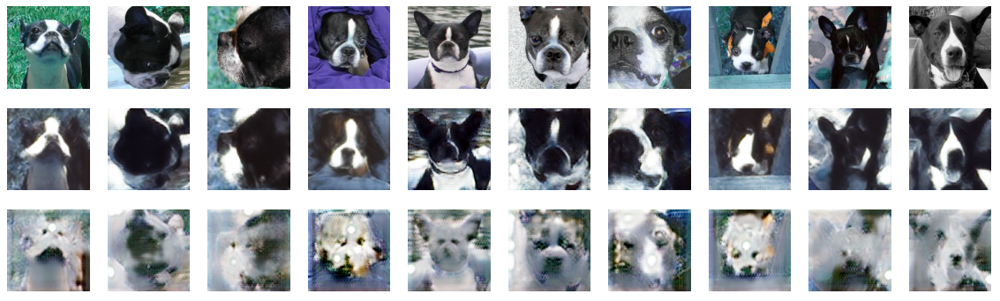

saved generator weights
saved discriminator weights
==== epoch 91
discriminator loss: B_on_real: 0.0202, B_on_fake: 0.0257, A_on_real: 0.0368, A_on_fake: 0.0670
generator A2B loss: total: 2.8853, adversarial: 1.0432, identity: 0.1325, forward: 0.0807, backward: 0.0902
generator B2A loss: total: 2.4564, adversarial: 0.6812, identity: 0.1046, forward: 0.0898, backward: 0.0772
==== epoch 92
discriminator loss: B_on_real: 0.0089, B_on_fake: 0.0234, A_on_real: 0.0328, A_on_fake: 0.0632
generator A2B loss: total: 2.5304, adversarial: 0.6668, identity: 0.1218, forward: 0.0848, backward: 0.0894
generator B2A loss: total: 2.4353, adversarial: 0.6569, identity: 0.1079, forward: 0.0880, backward: 0.0791


KeyboardInterrupt: 

In [60]:
epochs = 10000000
batch_size = 16
n_batch = 16
ai = math.ceil(len(train_data_A) / batch_size)
bi = math.ceil(len(train_data_B) / batch_size)
ii = min(ai, bi)

output_dir = Path(model_dir)
output_dir.mkdir(parents=True, exist_ok=True)

my_model.load_weights()

poolA, poolB = list(), list()

for epoch in range(epochs):
        
    n_patch = d_A.output_shape[1]
    
    for i in range(ii-1):
        
        # select a batch of real samples
        X_realA, y_realA = generate_real_samples(train_data_A[batch_size*i:batch_size*(i+1)], n_batch, n_patch)
        X_realB, y_realB = generate_real_samples(train_data_B[batch_size*i:batch_size*(i+1)], n_batch, n_patch)
        # generate a batch of fake samples
        X_fakeA, y_fakeA = generate_fake_samples(g_B2A, X_realB, n_patch)
        X_fakeB, y_fakeB = generate_fake_samples(g_A2B, X_realA, n_patch)
        # update fakes from pool
        X_fakeA_pool = update_image_pool(poolA, X_fakeA)
        X_fakeB_pool = update_image_pool(poolB, X_fakeB)

        # update generator A->B via adversarial and cycle loss
        total_A2B, a_A2B, identity_A2B, f_A2B, b_A2B = c_model_AtoB.train_on_batch([X_realA, X_realB], [y_realB, X_realB, X_realA, X_realB])

        # update discriminator for B -> [real/fake]
        dB_loss1 = d_B.train_on_batch(X_realB, y_realB)
        dB_loss2 = d_B.train_on_batch(X_fakeB_pool, y_fakeB)
        
        # update generator B->A via adversarial and cycle loss
        total_B2A, a_B2A, identity_B2A, f_B2A, b_B2A  = c_model_BtoA.train_on_batch([X_realB, X_realA], [y_realA, X_realA, X_realB, X_realA])

        # update discriminator for A -> [real/fake]
        dA_loss1 = d_A.train_on_batch(X_realA, y_realA)
        dA_loss2 = d_A.train_on_batch(X_fakeA_pool, y_fakeA)
        
        
    print('==== epoch {}'.format(epoch))
    print('discriminator loss: B_on_real: {:.4f}, B_on_fake: {:.4f}, A_on_real: {:.4f}, A_on_fake: {:.4f}'.format(dB_loss1, dB_loss2, dA_loss1, dA_loss2))
    print('generator A2B loss: total: {:.4f}, adversarial: {:.4f}, identity: {:.4f}, forward: {:.4f}, backward: {:.4f}'.format(total_A2B, a_A2B, identity_A2B, f_A2B, b_A2B))
    print('generator B2A loss: total: {:.4f}, adversarial: {:.4f}, identity: {:.4f}, forward: {:.4f}, backward: {:.4f}'.format(total_B2A, a_B2A, identity_B2A, f_B2A, b_B2A))
    
    if epoch % 10 == 0:
        print('============= train set ================')
        predictions_AA = g_B2A.predict(X_realA)
        print('====== A as input')
        display3(X_realA, predictions_AA, X_fakeB)
        
        predictions_BB = g_A2B.predict(X_realB)
        print('====== B as input')
        display3(X_realB, predictions_BB, X_fakeA)
        
        print('============= test set ================')
        predictions_AA = g_B2A.predict(test_data_A)
        predictions_AB = g_A2B.predict(test_data_A)
        print('====== A as input')
        display3(test_data_A, predictions_AA, predictions_AB)
        
        predictions_BB = g_A2B.predict(test_data_B)
        predictions_BA = g_B2A.predict(test_data_B)
        print('====== B as input')
        display3(test_data_B, predictions_BB, predictions_BA)
        
        my_model.save_weights()
        
    
    